In [204]:
!pip install ultralytics

In [205]:
import numpy as np 
import pandas as pd
import cv2
import os
from PIL import Image 
import matplotlib.pyplot as plt 
from pprint import pprint
from tqdm import tqdm
import glob
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2
from torchvision.transforms import functional as F
from ultralytics import YOLO
import time

In [206]:
dataset_path = "/kaggle/input/images"
os.listdir(dataset_path)

['Pedestrian_01.jpg',
 'camourflage_00498.jpg',
 'camourflage_00478.jpg',
 'camourflage_00473.jpg',
 'pedestrian-05.jpg',
 'linh-ban-tia-4.jpg',
 'camourflage_00496.jpg',
 'linh-ban-tia-3.jpg',
 'linh-ban-tia.jpg',
 'linh-ban-tia-6.jpg',
 'Pedestrian_02.jpg',
 'camourflage_00471.jpg',
 'linh-ban-tia-2.jpg',
 'pedestrian-03.jpg',
 'pedestrian-04.jpg',
 'camourflage_00470.jpg',
 'linh-ban-tia-5.jpg']

In [207]:
device = ("cuda" if torch.cuda.is_available() else "cpu")
device

'cuda'

**<p style="color: cyan; font-size : 30pt">Fast_RCNN</p>**

In [208]:
image_paths = glob.glob("/kaggle/input/images/Pedestrian*.jpg") + glob.glob("/kaggle/input/images/pedestrian*.jpg")
image_test_paths = glob.glob("/kaggle/input/images/camourflage*.jpg") + glob.glob("/kaggle/input/images/linh-ban-tia*.jpg")

In [209]:
model = fasterrcnn_resnet50_fpn_v2(weights="DEFAULT")
model = model.to(device)
model.eval()

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

In [210]:
def plot_image(image_path, boxes, labels, scores, threshold= 0.5):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    for i, box in enumerate(boxes):
        if scores[i] >= threshold:
            x1, y1, x2, y2 = map(int, box)  
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 0, 255), thickness=2)
            label = f"Label: {labels[i]}, Score: {scores[i]:.2f}"
            cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
    plt.imshow(image)
    plt.axis("off")
    plt.show()


'Plot Image Path: /kaggle/input/images/Pedestrian_01.jpg'
'Number of Person: 16'
'Time to detect image: 0.1329 seconds'


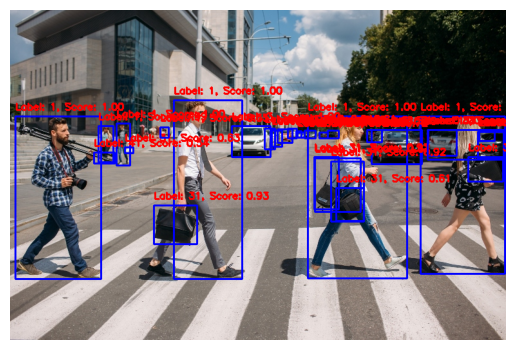

'Plot Image Path: /kaggle/input/images/Pedestrian_02.jpg'
'Number of Person: 31'
'Time to detect image: 0.1140 seconds'


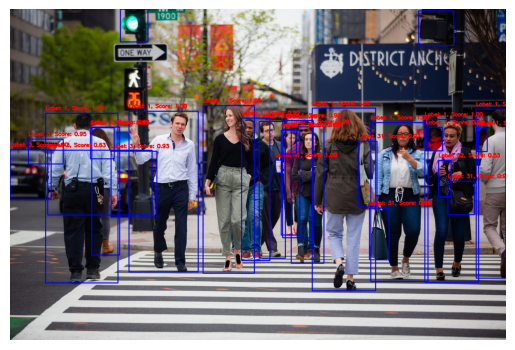

'Plot Image Path: /kaggle/input/images/pedestrian-05.jpg'
'Number of Person: 45'
'Time to detect image: 0.1029 seconds'


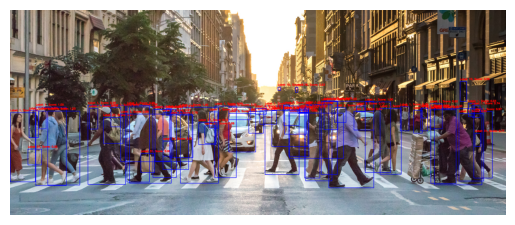

'Plot Image Path: /kaggle/input/images/pedestrian-03.jpg'
'Number of Person: 5'
'Time to detect image: 0.1128 seconds'


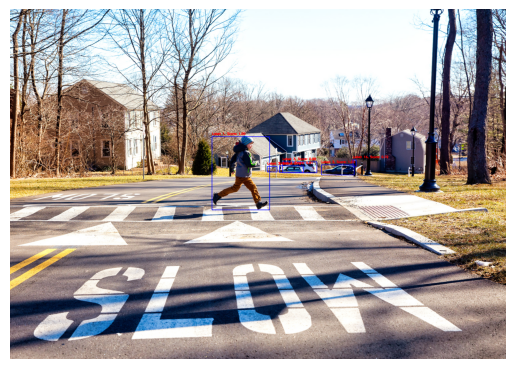

'Plot Image Path: /kaggle/input/images/pedestrian-04.jpg'
'Number of Person: 56'
'Time to detect image: 0.0841 seconds'


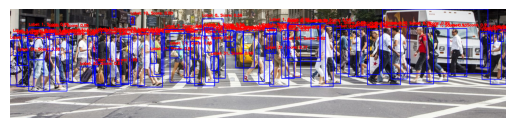

In [211]:
for image_path in image_paths:
    image = Image.open(image_path)
    image = F.to_tensor(image).unsqueeze(0).to(device)
    start_time = time.time()
    with torch.no_grad():
        pred = model(image)
    end_time = time.time()
    boxes = pred[0]['boxes'].cpu().numpy()  
    labels = pred[0]['labels'].cpu().numpy()  
    scores = pred[0]['scores'].cpu().numpy()
    person_count = sum(1 for i in range(len(labels)) if labels[i] == 1)
    pprint("Plot Image Path: {}".format(image_path))
    pprint("Number of Person: {}".format(person_count))
    pprint("Time to detect image: {:.4f} seconds".format((end_time - start_time)))
    plot_image(image_path, boxes, labels, scores)

# **Test Image**

'Plot Image Path: /kaggle/input/images/camourflage_00498.jpg'
'Time to detect image: 0.1060 seconds'


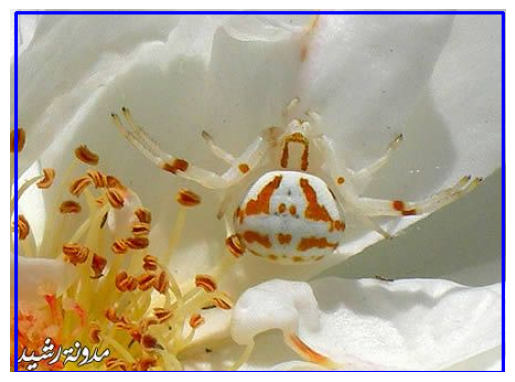

'Plot Image Path: /kaggle/input/images/camourflage_00478.jpg'
'Time to detect image: 0.1075 seconds'


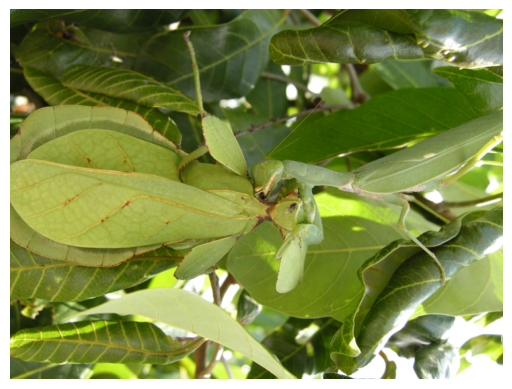

'Plot Image Path: /kaggle/input/images/camourflage_00473.jpg'
'Time to detect image: 0.1125 seconds'


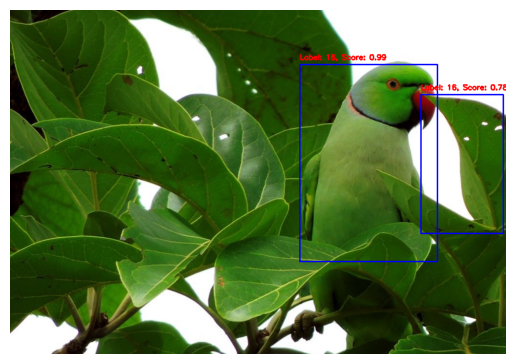

'Plot Image Path: /kaggle/input/images/camourflage_00496.jpg'
'Time to detect image: 0.1062 seconds'


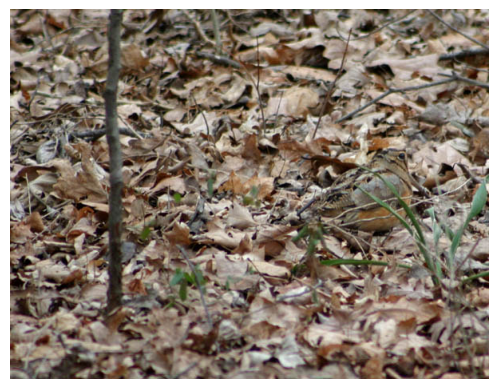

'Plot Image Path: /kaggle/input/images/camourflage_00471.jpg'
'Time to detect image: 0.1134 seconds'


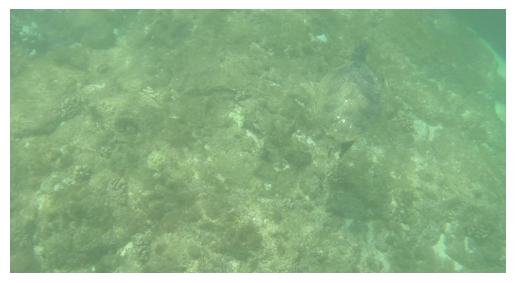

'Plot Image Path: /kaggle/input/images/camourflage_00470.jpg'
'Time to detect image: 0.1162 seconds'


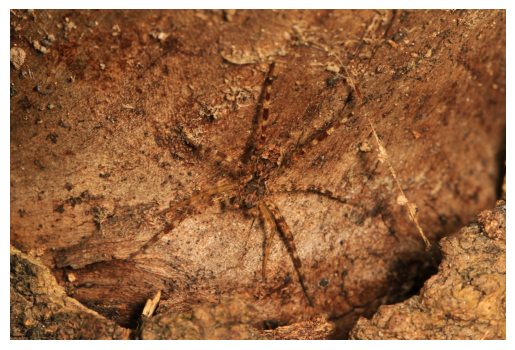

'Plot Image Path: /kaggle/input/images/linh-ban-tia-4.jpg'
'Time to detect image: 0.1139 seconds'


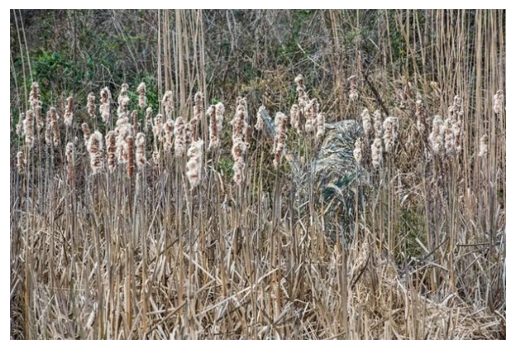

'Plot Image Path: /kaggle/input/images/linh-ban-tia-3.jpg'
'Time to detect image: 0.1132 seconds'


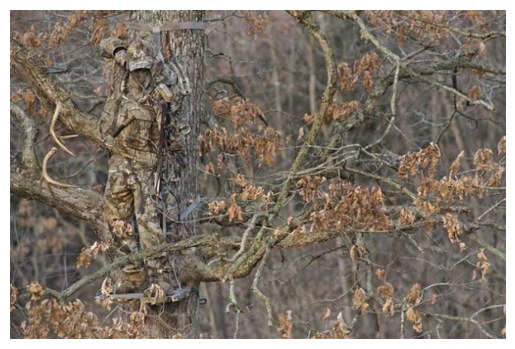

'Plot Image Path: /kaggle/input/images/linh-ban-tia.jpg'
'Time to detect image: 0.1150 seconds'


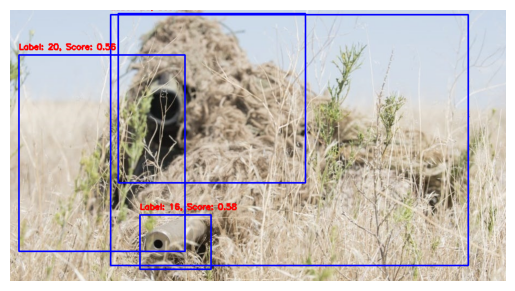

'Plot Image Path: /kaggle/input/images/linh-ban-tia-6.jpg'
'Time to detect image: 0.1141 seconds'


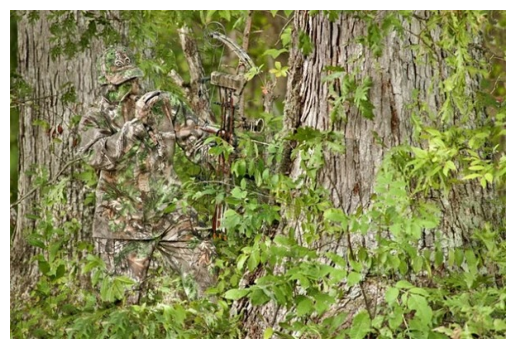

'Plot Image Path: /kaggle/input/images/linh-ban-tia-2.jpg'
'Time to detect image: 0.1112 seconds'


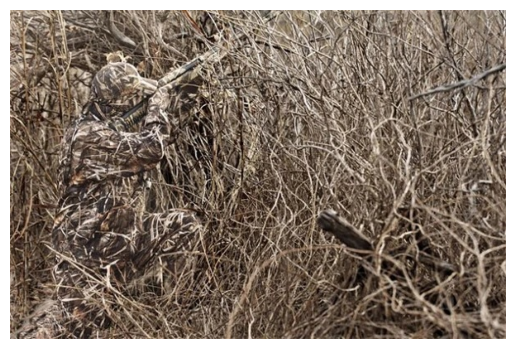

'Plot Image Path: /kaggle/input/images/linh-ban-tia-5.jpg'
'Time to detect image: 0.1071 seconds'


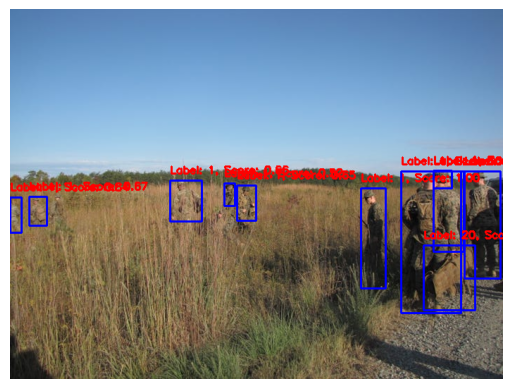

In [212]:
for image_path in image_test_paths:
    image = Image.open(image_path)
    image = F.to_tensor(image).unsqueeze(0).to(device)
    
    start_time = time.time()
    with torch.no_grad():
        pred = model(image)
    end_time = time.time()
    
    boxes = pred[0]['boxes'].cpu().numpy()  
    labels = pred[0]['labels'].cpu().numpy()  
    scores = pred[0]['scores'].cpu().numpy()
    
    mask = scores >= 0.5
    boxes = boxes[mask]
    labels = labels[mask]
    scores = scores[mask]
    pprint("Plot Image Path: {}".format(image_path))
    pprint("Time to detect image: {:.4f} seconds".format(end_time - start_time))
    plot_image(image_path, boxes, labels, scores)

**<p style="color: cyan; font-size : 30pt">YOLOv5m</p>**

In [213]:
model = YOLO("yolov5m.pt")

PRO TIP 💡 Replace 'model=yolov5m.pt' with new 'model=yolov5mu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



In [214]:
def plot_image_yolo(image_path, boxes):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    for box in boxes:  
        x1, y1, x2, y2 = map(int, box.xyxy[0]) 
        label = int(box.cls[0])  
        confidence = box.conf[0]  

        cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)
        cv2.putText(image, f"Person {confidence:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)

    plt.imshow(image)
    plt.axis('off')
    plt.show()



image 1/1 /kaggle/input/images/Pedestrian_01.jpg: 448x640 6 persons, 9 cars, 3 handbags, 13.1ms
Speed: 2.7ms preprocess, 13.1ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
'Plot Image Path: /kaggle/input/images/Pedestrian_01.jpg'
'Number of Person: 6'
'Time to detect iamge: 0.366563 seconds'


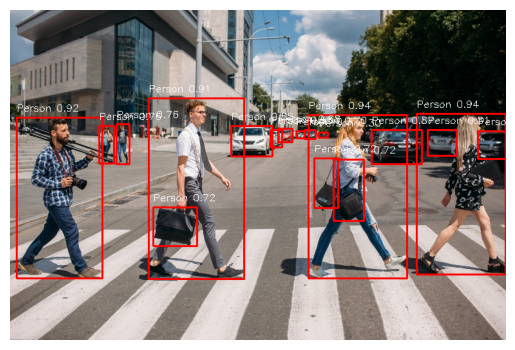


image 1/1 /kaggle/input/images/Pedestrian_02.jpg: 448x640 16 persons, 2 cars, 1 traffic light, 4 handbags, 11.2ms
Speed: 2.4ms preprocess, 11.2ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
'Plot Image Path: /kaggle/input/images/Pedestrian_02.jpg'
'Number of Person: 16'
'Time to detect iamge: 0.029752 seconds'


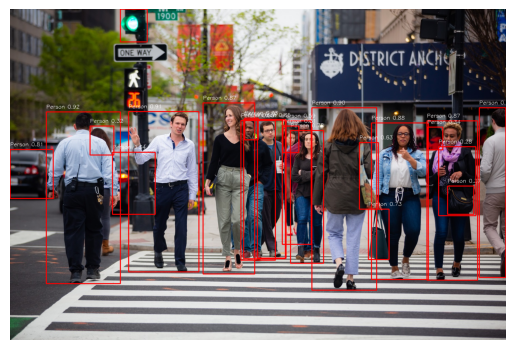


image 1/1 /kaggle/input/images/pedestrian-05.jpg: 288x640 19 persons, 7 cars, 1 backpack, 4 handbags, 11.2ms
Speed: 1.9ms preprocess, 11.2ms inference, 1.4ms postprocess per image at shape (1, 3, 288, 640)
'Plot Image Path: /kaggle/input/images/pedestrian-05.jpg'
'Number of Person: 19'
'Time to detect iamge: 0.084950 seconds'


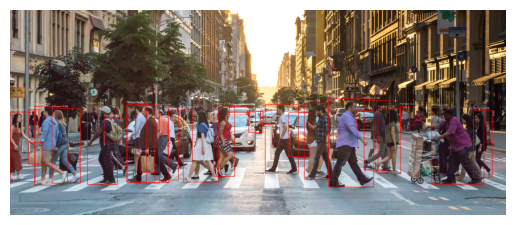


image 1/1 /kaggle/input/images/pedestrian-03.jpg: 480x640 1 person, 2 cars, 13.0ms
Speed: 2.6ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
'Plot Image Path: /kaggle/input/images/pedestrian-03.jpg'
'Number of Person: 1'
'Time to detect iamge: 0.078537 seconds'


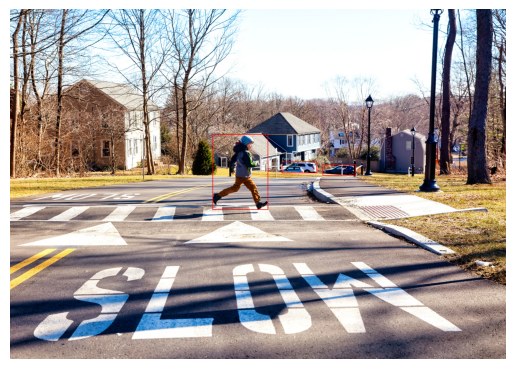


image 1/1 /kaggle/input/images/pedestrian-04.jpg: 160x640 26 persons, 4 cars, 1 truck, 1 handbag, 11.3ms
Speed: 1.2ms preprocess, 11.3ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)
'Plot Image Path: /kaggle/input/images/pedestrian-04.jpg'
'Number of Person: 26'
'Time to detect iamge: 0.027257 seconds'


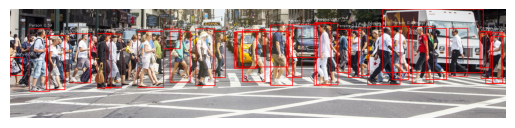

In [215]:
for image_path in image_paths:
    start_time = time.time()  
    
    results = model(image_path) 
    end_time = time.time()
    boxes = results[0].boxes  
    person_count = sum(1 for box in boxes if int(box.cls[0]) == 0 )

    pprint("Plot Image Path: {}".format(image_path))
    pprint("Number of Person: {}".format(person_count))
    pprint("Time to detect iamge: {:4f} seconds".format((end_time - start_time)))  
    
    plot_image_yolo(image_path, boxes)


# **Test Image**


image 1/1 /kaggle/input/images/camourflage_00498.jpg: 480x640 (no detections), 14.3ms
Speed: 2.2ms preprocess, 14.3ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Time to detect image: 0.0257 seconds


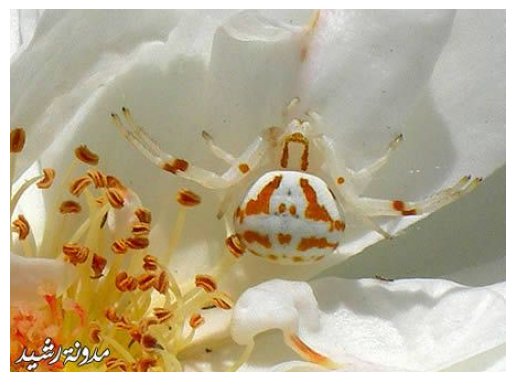


image 1/1 /kaggle/input/images/camourflage_00478.jpg: 480x640 1 orange, 13.2ms
Speed: 2.1ms preprocess, 13.2ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
Time to detect image: 0.0418 seconds


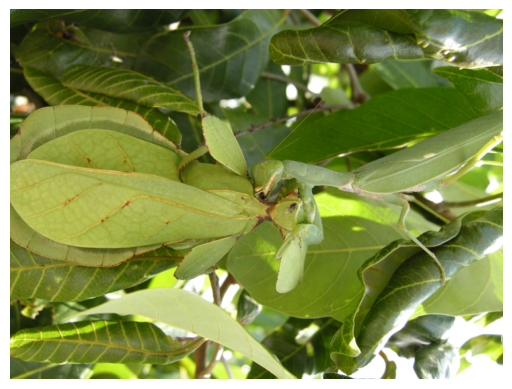


image 1/1 /kaggle/input/images/camourflage_00473.jpg: 448x640 1 bird, 1 apple, 12.9ms
Speed: 2.3ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0264 seconds


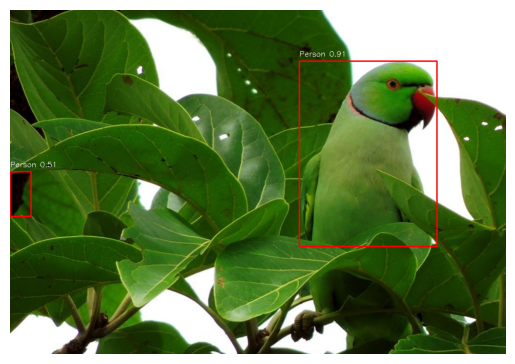


image 1/1 /kaggle/input/images/camourflage_00496.jpg: 512x640 (no detections), 14.7ms
Speed: 2.1ms preprocess, 14.7ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)
Time to detect image: 0.0252 seconds


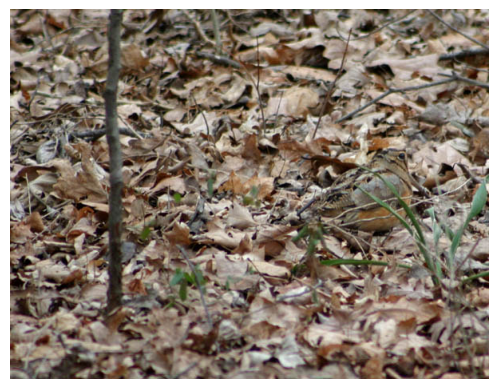


image 1/1 /kaggle/input/images/camourflage_00471.jpg: 352x640 (no detections), 15.6ms
Speed: 2.8ms preprocess, 15.6ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Time to detect image: 0.0290 seconds


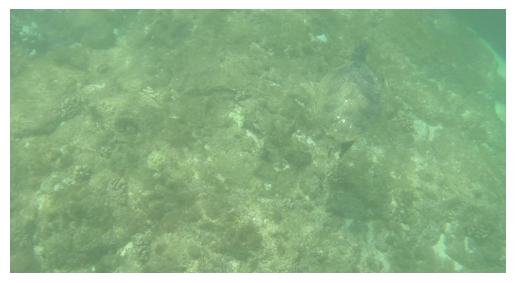


image 1/1 /kaggle/input/images/camourflage_00470.jpg: 448x640 1 cake, 12.9ms
Speed: 3.1ms preprocess, 12.9ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.1735 seconds


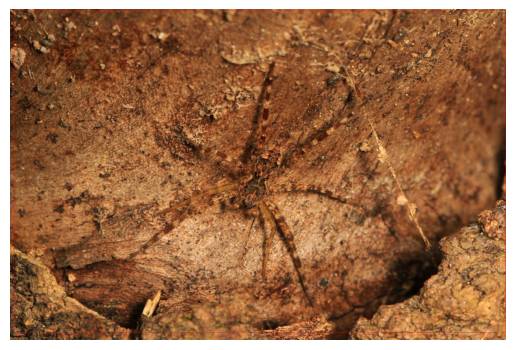


image 1/1 /kaggle/input/images/linh-ban-tia-4.jpg: 448x640 (no detections), 12.0ms
Speed: 1.9ms preprocess, 12.0ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0218 seconds


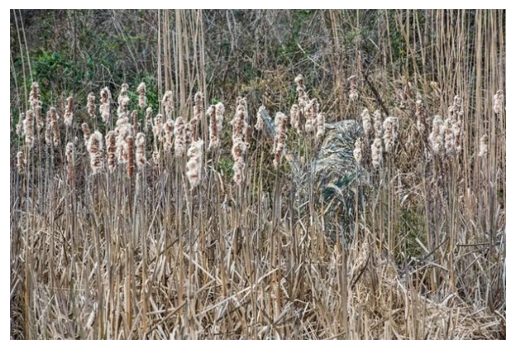


image 1/1 /kaggle/input/images/linh-ban-tia-3.jpg: 448x640 (no detections), 12.1ms
Speed: 2.0ms preprocess, 12.1ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0215 seconds


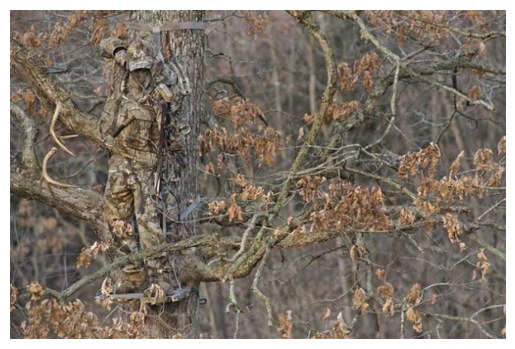


image 1/1 /kaggle/input/images/linh-ban-tia.jpg: 352x640 (no detections), 15.6ms
Speed: 2.7ms preprocess, 15.6ms inference, 0.7ms postprocess per image at shape (1, 3, 352, 640)
Time to detect image: 0.0283 seconds


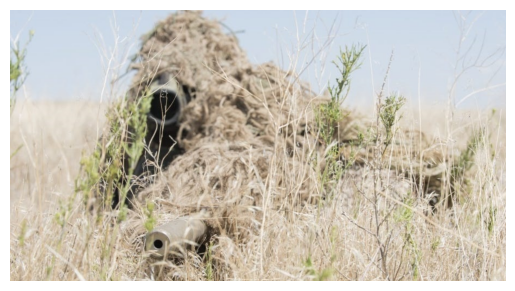


image 1/1 /kaggle/input/images/linh-ban-tia-6.jpg: 448x640 1 person, 14.1ms
Speed: 2.8ms preprocess, 14.1ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0270 seconds


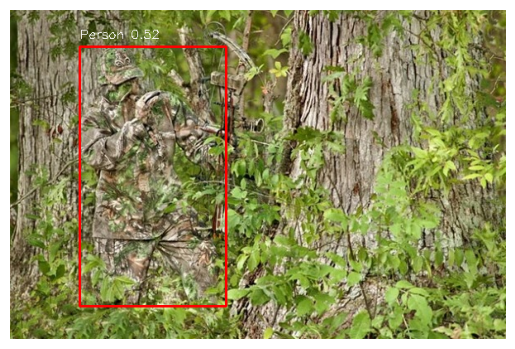


image 1/1 /kaggle/input/images/linh-ban-tia-2.jpg: 448x640 1 bird, 18.3ms
Speed: 3.9ms preprocess, 18.3ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0361 seconds


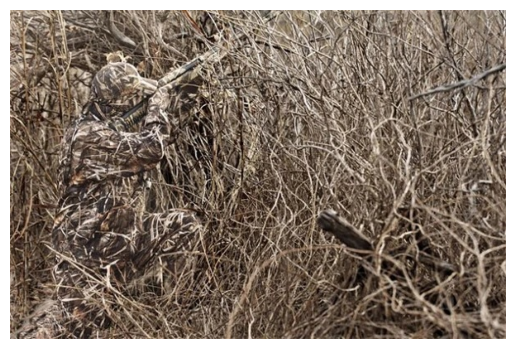


image 1/1 /kaggle/input/images/linh-ban-tia-5.jpg: 480x640 3 persons, 1 dog, 14.2ms
Speed: 2.2ms preprocess, 14.2ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
Time to detect image: 0.0282 seconds


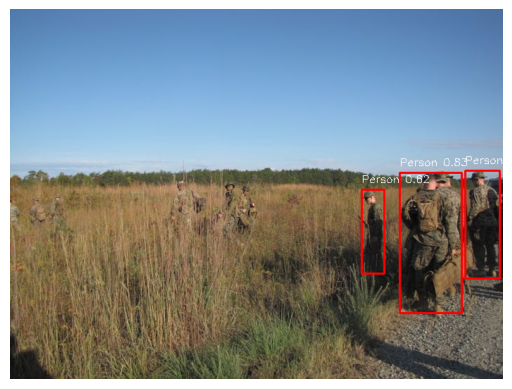

In [216]:
for image_path in image_test_paths:
    start_time = time.time()  
    results = model(image_path) 
    end_time = time.time()

    boxes = results[0].boxes  
    filtered_boxes = []  

    for box in boxes:
        if box.conf[0] > 0.5:  
            filtered_boxes.append(box)

    print("Time to detect image: {:.4f} seconds".format(end_time - start_time))
    plot_image_yolo(image_path, filtered_boxes)


**<p style="color: cyan; font-size : 30pt">YOLOv8m</p>**

In [217]:
model = YOLO("yolov8m.pt")


image 1/1 /kaggle/input/images/Pedestrian_01.jpg: 448x640 6 persons, 12 cars, 5 handbags, 14.0ms
Speed: 2.1ms preprocess, 14.0ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
'Plot Image Path: /kaggle/input/images/Pedestrian_01.jpg'
'Number of Person: 6'
'Time to detect iamge: 0.355509 seconds'


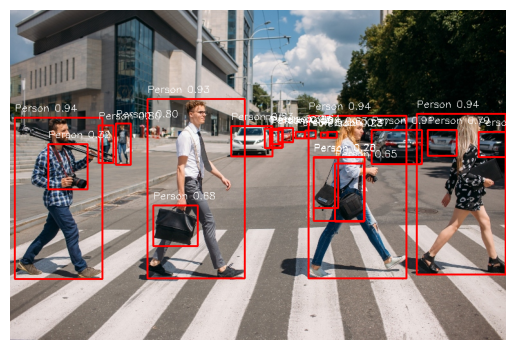


image 1/1 /kaggle/input/images/Pedestrian_02.jpg: 448x640 16 persons, 3 cars, 4 traffic lights, 5 handbags, 1 cup, 13.0ms
Speed: 2.6ms preprocess, 13.0ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
'Plot Image Path: /kaggle/input/images/Pedestrian_02.jpg'
'Number of Person: 16'
'Time to detect iamge: 0.032096 seconds'


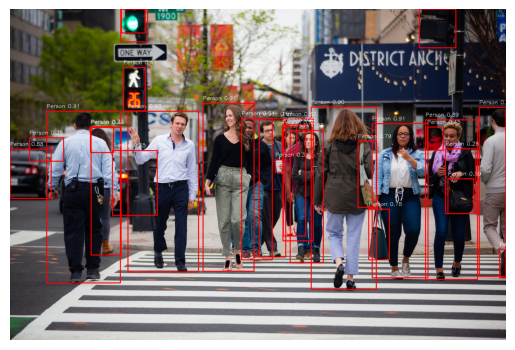


image 1/1 /kaggle/input/images/pedestrian-05.jpg: 288x640 25 persons, 9 cars, 2 traffic lights, 2 backpacks, 2 handbags, 12.0ms
Speed: 1.8ms preprocess, 12.0ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 640)
'Plot Image Path: /kaggle/input/images/pedestrian-05.jpg'
'Number of Person: 25'
'Time to detect iamge: 0.081628 seconds'


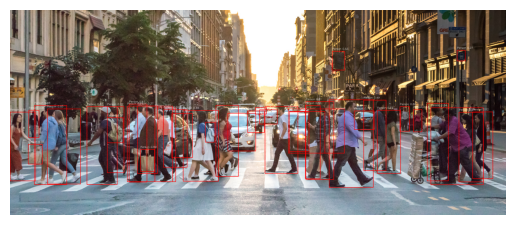


image 1/1 /kaggle/input/images/pedestrian-03.jpg: 480x640 1 person, 3 cars, 15.0ms
Speed: 2.6ms preprocess, 15.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
'Plot Image Path: /kaggle/input/images/pedestrian-03.jpg'
'Number of Person: 1'
'Time to detect iamge: 0.076694 seconds'


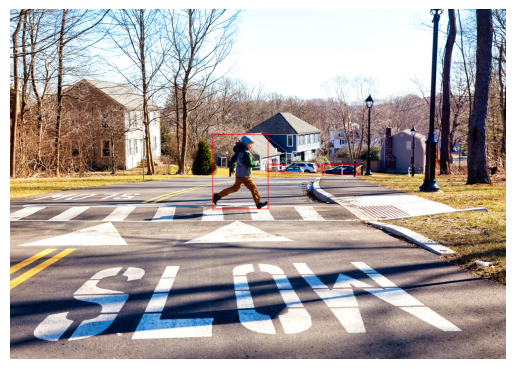


image 1/1 /kaggle/input/images/pedestrian-04.jpg: 160x640 30 persons, 4 cars, 1 truck, 2 handbags, 12.7ms
Speed: 1.7ms preprocess, 12.7ms inference, 1.4ms postprocess per image at shape (1, 3, 160, 640)
'Plot Image Path: /kaggle/input/images/pedestrian-04.jpg'
'Number of Person: 30'
'Time to detect iamge: 0.032361 seconds'


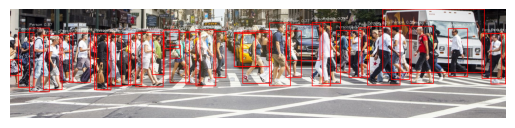

In [218]:
for image_path in image_paths:
    start_time = time.time()  
    
    results = model(image_path) 
    end_time = time.time()
    boxes = results[0].boxes  
    person_count = sum(1 for box in boxes if int(box.cls[0]) == 0 and box.conf[0] >= 0.25)

    pprint("Plot Image Path: {}".format(image_path))
    pprint("Number of Person: {}".format(person_count))
    pprint("Time to detect iamge: {:4f} seconds".format((end_time - start_time)))  
    
    plot_image_yolo(image_path, boxes)


# **Test Image**


image 1/1 /kaggle/input/images/camourflage_00498.jpg: 480x640 (no detections), 20.7ms
Speed: 4.2ms preprocess, 20.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
Time to detect image: 0.0375 seconds


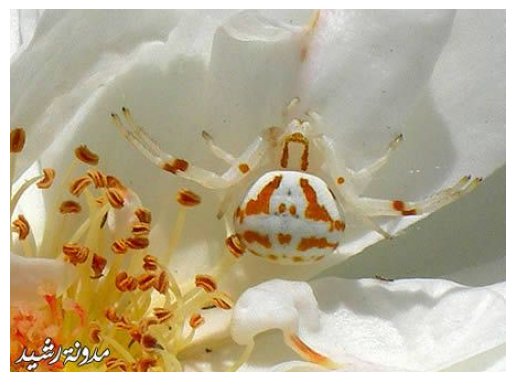


image 1/1 /kaggle/input/images/camourflage_00478.jpg: 480x640 (no detections), 14.1ms
Speed: 2.2ms preprocess, 14.1ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
Time to detect image: 0.0383 seconds


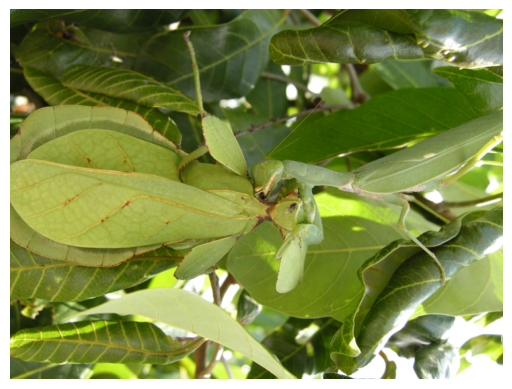


image 1/1 /kaggle/input/images/camourflage_00473.jpg: 448x640 2 birds, 13.8ms
Speed: 2.4ms preprocess, 13.8ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0256 seconds


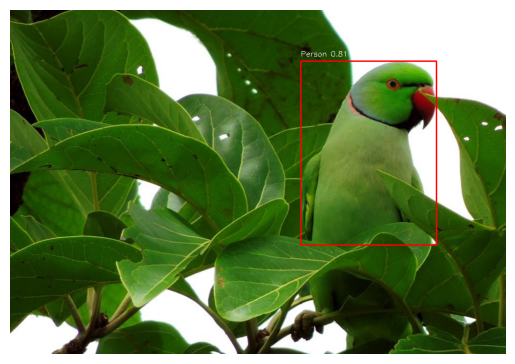


image 1/1 /kaggle/input/images/camourflage_00496.jpg: 512x640 (no detections), 16.0ms
Speed: 2.2ms preprocess, 16.0ms inference, 0.6ms postprocess per image at shape (1, 3, 512, 640)
Time to detect image: 0.0268 seconds


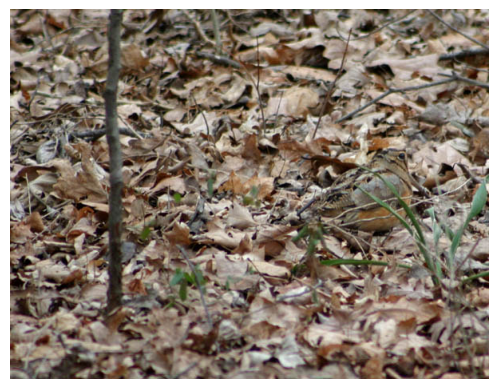


image 1/1 /kaggle/input/images/camourflage_00471.jpg: 352x640 (no detections), 13.4ms
Speed: 2.7ms preprocess, 13.4ms inference, 0.6ms postprocess per image at shape (1, 3, 352, 640)
Time to detect image: 0.0259 seconds


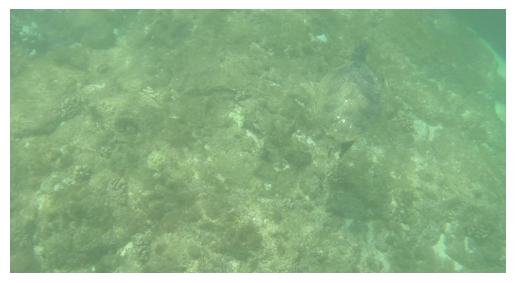


image 1/1 /kaggle/input/images/camourflage_00470.jpg: 448x640 (no detections), 13.9ms
Speed: 3.0ms preprocess, 13.9ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.1730 seconds


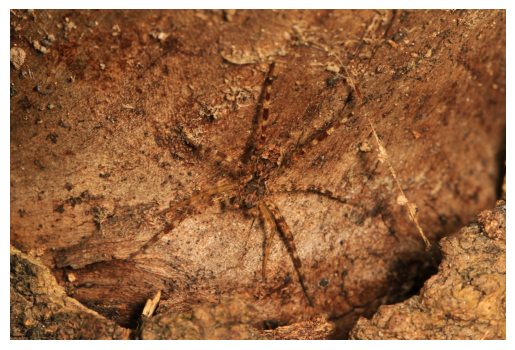


image 1/1 /kaggle/input/images/linh-ban-tia-4.jpg: 448x640 (no detections), 12.9ms
Speed: 2.1ms preprocess, 12.9ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0228 seconds


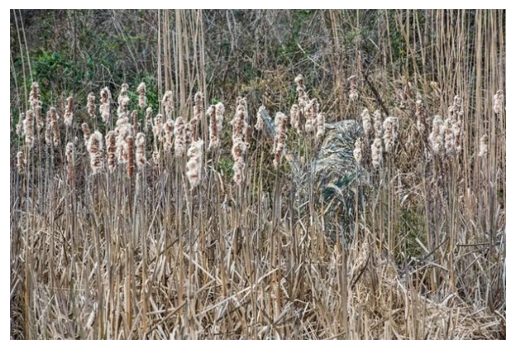


image 1/1 /kaggle/input/images/linh-ban-tia-3.jpg: 448x640 (no detections), 12.9ms
Speed: 2.7ms preprocess, 12.9ms inference, 0.7ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0236 seconds


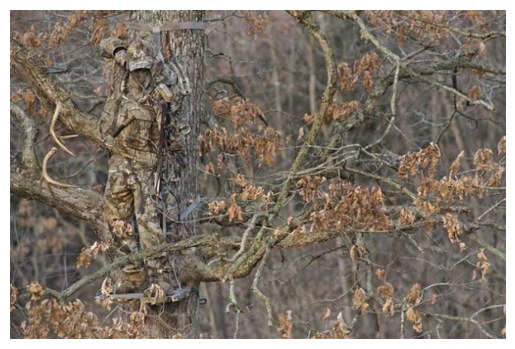


image 1/1 /kaggle/input/images/linh-ban-tia.jpg: 352x640 1 sheep, 13.9ms
Speed: 2.8ms preprocess, 13.9ms inference, 1.6ms postprocess per image at shape (1, 3, 352, 640)
Time to detect image: 0.0267 seconds


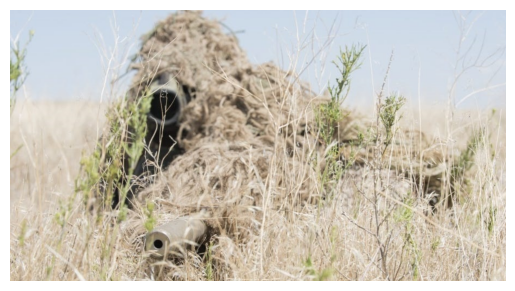


image 1/1 /kaggle/input/images/linh-ban-tia-6.jpg: 448x640 1 person, 14.5ms
Speed: 3.6ms preprocess, 14.5ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0293 seconds


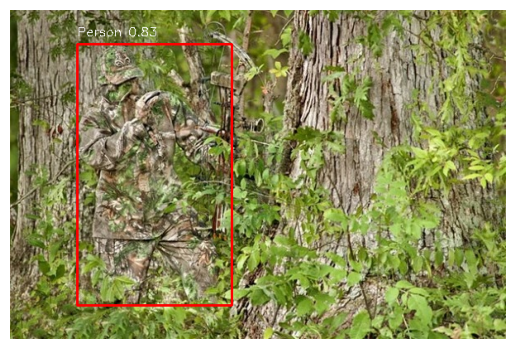


image 1/1 /kaggle/input/images/linh-ban-tia-2.jpg: 448x640 1 fire hydrant, 12.6ms
Speed: 2.8ms preprocess, 12.6ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)
Time to detect image: 0.0254 seconds


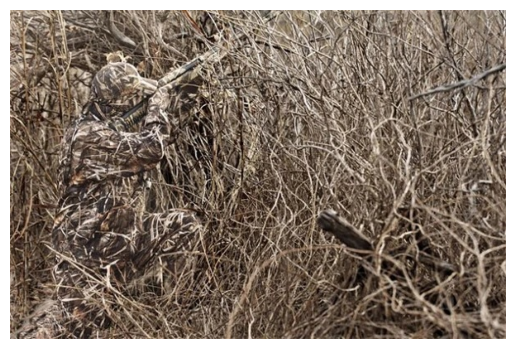


image 1/1 /kaggle/input/images/linh-ban-tia-5.jpg: 480x640 8 persons, 14.8ms
Speed: 3.1ms preprocess, 14.8ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)
Time to detect image: 0.0328 seconds


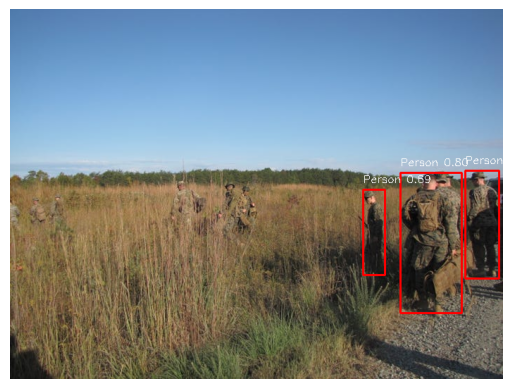

In [219]:
for image_path in image_test_paths:
    start_time = time.time()  
    results = model(image_path) 
    end_time = time.time()

    boxes = results[0].boxes  
    filtered_boxes = []  

    for box in boxes:
        if box.conf[0] > 0.5:  
            filtered_boxes.append(box)

    print("Time to detect image: {:.4f} seconds".format(end_time - start_time))
    plot_image_yolo(image_path, filtered_boxes)